<a href="https://colab.research.google.com/github/aljabarti84/inside-the-match/blob/main/Inside_The_Match_Final_Notebook.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 🧠 Inside The Match – Final AI & VR Prototype

In [1]:
!pip install -q ultralytics opencv-python-headless pandas matplotlib seaborn


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 994.0/994.0 kB 20.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 50.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 29.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 26.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 11.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 91.3 MB/s eta 0:00:00


In [2]:
from ultralytics import YOLO
import cv2
import os
import pandas as pd
import json
import matplotlib.pyplot as plt
import seaborn as sns
from google.colab import files
from IPython.display import HTML
from base64 import b64encode


Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [3]:
model = YOLO('yolov8n.pt')


100%|██████████| 6.25M/6.25M [00:00<00:00, 310MB/s]


In [4]:
uploaded_video = files.upload()
video_path = list(uploaded_video.keys())[0]

cap = cv2.VideoCapture(video_path)
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
fps = cap.get(cv2.CAP_PROP_FPS)

output_path = "annotated_video.mp4"
out = cv2.VideoWriter(output_path, cv2.VideoWriter_fourcc(*'mp4v'), fps, (width, height))

frame_count = 0
while cap.isOpened():
    ret, frame = cap.read()
    if not ret or frame_count > 100:
        break
    results = model(frame)
    annotated = results[0].plot()
    out.write(annotated)
    frame_count += 1
cap.release()
out.release()


Saving 2932301-uhd_4096_2160_24fps.mp4 to 2932301-uhd_4096_2160_24fps.mp4

0: 352x640 7 persons, 2 cars, 2 benchs, 1 backpack, 54.4ms
Speed: 22.2ms preprocess, 54.4ms inference, 436.0ms postprocess per image at shape (1, 3, 352, 640)

0: 352x640 7 persons, 3 cars, 11.0ms
Speed: 3.7ms preprocess, 11.0ms inference, 1.9ms postprocess per image at shape (1, 3, 352, 640)

0: 352x640 8 persons, 2 cars, 1 sports ball, 11.0ms
Speed: 3.7ms preprocess, 11.0ms inference, 2.1ms postprocess per image at shape (1, 3, 352, 640)

0: 352x640 7 persons, 2 cars, 1 bench, 1 sports ball, 15.0ms
Speed: 5.4ms preprocess, 15.0ms inference, 2.6ms postprocess per image at shape (1, 3, 352, 640)

0: 352x640 6 persons, 1 car, 3 benchs, 1 sports ball, 11.0ms
Speed: 3.4ms preprocess, 11.0ms inference, 1.4ms postprocess per image at shape (1, 3, 352, 640)

0: 352x640 6 persons, 1 car, 3 benchs, 1 sports ball, 11.5ms
Speed: 3.5ms preprocess, 11.5ms inference, 1.8ms postprocess per image at shape (1, 3, 352, 640)

0: 

In [5]:
mp4 = open("annotated_video.mp4",'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML(f'<video width=600 controls><source src="{data_url}" type="video/mp4">')


In [6]:
uploaded_json = files.upload()
json_path = list(uploaded_json.keys())[0]
with open(json_path, 'r', encoding='utf-8') as f:
    data = json.load(f)
df = pd.json_normalize(data)


Saving 16010.json to 16010.json


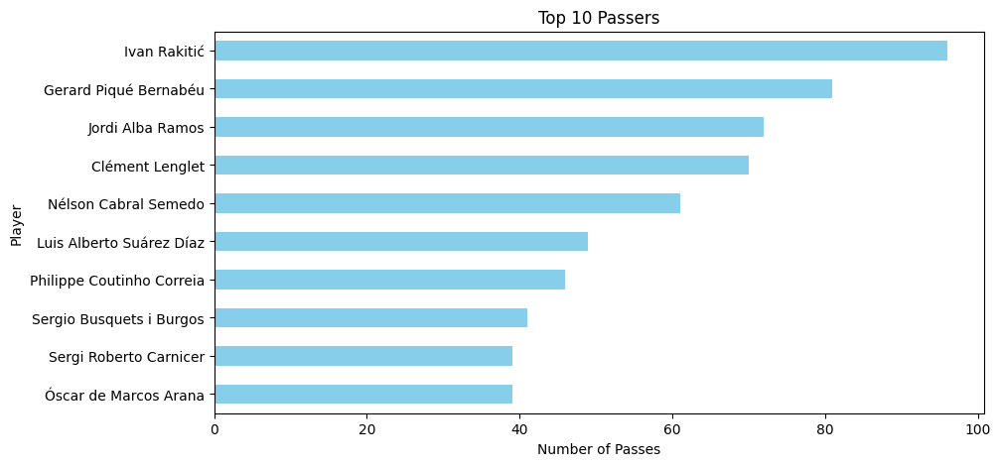

In [7]:
passes = df[df['type.name'] == 'Pass']
top_passers = passes['player.name'].value_counts().head(10)
top_passers.plot(kind='barh', color='skyblue', figsize=(10,5), title='Top 10 Passers')
plt.xlabel("Number of Passes")
plt.ylabel("Player")
plt.gca().invert_yaxis()
plt.show()


<ipython-input-8-609ed5ee9ead>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  shots[['x', 'y']] = shots['location'].apply(pd.Series)
<ipython-input-8-609ed5ee9ead>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  shots[['x', 'y']] = shots['location'].apply(pd.Series)
<ipython-input-8-609ed5ee9ead>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata

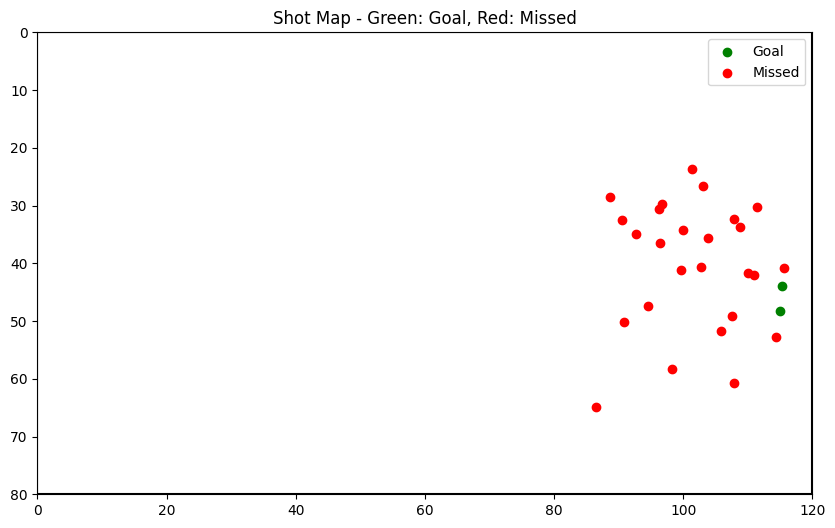

In [8]:
shots = df[df['type.name'] == 'Shot']
shots[['x', 'y']] = shots['location'].apply(pd.Series)
shots['is_goal'] = shots['shot.outcome.name'] == 'Goal'
plt.figure(figsize=(10,6))
plt.plot([0, 120], [0, 0], color="black")
plt.plot([0, 0], [0, 80], color="black")
plt.plot([120, 120], [0, 80], color="black")
plt.plot([0, 120], [80, 80], color="black")
plt.scatter(shots['x'][shots['is_goal']], shots['y'][shots['is_goal']], color='green', label='Goal')
plt.scatter(shots['x'][~shots['is_goal']], shots['y'][~shots['is_goal']], color='red', label='Missed')
plt.title("Shot Map - Green: Goal, Red: Missed")
plt.xlim(0, 120)
plt.ylim(0, 80)
plt.legend()
plt.gca().invert_yaxis()
plt.show()


In [10]:
!git config --global user.email "emanattalah@gmail.com"
!git config --global user.name "Eman Aljabarti"
